### В этом ноутбуке визуализирую данные с помощью folium.

In [1]:
import folium
from folium import plugins
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import json

%matplotlib inline

In [4]:
divvyStations_q3 = pd.read_csv('Divvy_Stations_2016_Q3.csv')
divvyStations_q4 = pd.read_csv('Divvy_Stations_2016_Q4.csv')

# combine and keep the first instance of id
divvyStations = pd.concat([divvyStations_q3, divvyStations_q4], axis=0).drop_duplicates(subset=['id'])

divvyStations.head()

,id,name,latitude,longitude,dpcapacity,online_date
0,456,2112 W Peterson Ave,41.991178,-87.683593,15,5/12/2015
1,101,63rd St Beach,41.781016,-87.576120,23,4/20/2015
2,109,900 W Harrison St,41.874675,-87.650019,19,8/6/2013
3,21,Aberdeen St & Jackson Blvd,41.877726,-87.654787,15,6/21/2013
4,80,Aberdeen St & Monroe St,41.880420,-87.655599,19,6/26/2013


In [248]:
m = folium.Map([41.8781, -87.6298], zoom_start=11)
m

In [237]:
# # mark each station as a point
# for index, row in divvyStations.iterrows():
#     folium.CircleMarker([row['latitude'], row['longitude']],
#                         radius=5,
# #                         popup=row['name'],
#                         fill_color="#ffffff", # divvy color
#                        ).add_to(m)

In [258]:
# convert to (n, 2) nd-array format for heatmap
stationArr = divvyStations[['latitude', 'longitude']].values#as_matrix()

# plot heatmap
m.add_child(plugins.HeatMap(stationArr, radius=15))
m

In [4]:
df = pd.read_csv('data_layer1.csv')
df.tail()

,longitude,latitude,param1,param2,param3,param4,param5,param6,layer
14443,-113.861111,35.799107,-1036.10,-7.475300e-08,-6.267400e-08,-1.489700e-09,6.220200e-09,7.468700e-08,1
14444,-113.861111,35.843750,-986.13,-7.201700e-08,-6.374400e-08,-3.887000e-10,4.154500e-09,7.369700e-08,1
14445,-113.861111,35.888393,-1138.90,-7.094300e-08,-6.749100e-08,-2.490800e-10,1.743900e-09,7.454500e-08,1
14446,-113.861111,35.933036,-1267.50,-6.971700e-08,-7.083000e-08,-3.902900e-10,6.798100e-10,7.554600e-08,1
14447,-113.861111,35.977679,-1371.30,-6.879500e-08,-7.360200e-08,-1.414600e-10,2.407600e-09,7.644600e-08,1


In [23]:
df['longitude'].describe()

count    14448.000000
mean      -117.416667
std          2.068848
min       -120.972222
25%       -119.194444
50%       -117.416667
75%       -115.638889
max       -113.861111
Name: longitude, dtype: float64

In [24]:
df['latitude'].describe()

count    14448.000000
mean        33.500000
std          1.443368
min         31.022321
25%         32.261161
50%         33.500000
75%         34.738839
max         35.977679
Name: latitude, dtype: float64

In [28]:
m = folium.Map([33.500000, -117.416667], zoom_start=6)
m

In [32]:
# mark each station as a point
for index, row in df.iterrows():
    folium.CircleMarker([row['latitude'], row['longitude']],
                        radius=1,
#                         popup=row['name'],
                        fill_color="#3db7e4", # divvy color
                       ).add_to(m)

In [33]:
# convert to (n, 2) nd-array format for heatmap
stationArr = df[['latitude', 'longitude']].values#as_matrix()

# plot heatmap
m.add_child(plugins.HeatMap(stationArr, radius=1))
m

In [2]:
def map_points(df, lat_col='latitude', lon_col='longitude', zoom_start=7, \
                plot_points=False, pt_radius=1, \
                draw_heatmap=False, heat_map_weights_col=None, \
                heat_map_weights_normalize=True, heat_map_radius=15):
    """Creates a map given a dataframe of points. Can also produce a heatmap overlay

    Arg:
        df: dataframe containing points to maps
        lat_col: Column containing latitude (string)
        lon_col: Column containing longitude (string)
        zoom_start: Integer representing the initial zoom of the map
        plot_points: Add points to map (boolean)
        pt_radius: Size of each point
        draw_heatmap: Add heatmap to map (boolean)
        heat_map_weights_col: Column containing heatmap weights
        heat_map_weights_normalize: Normalize heatmap weights (boolean)
        heat_map_radius: Size of heatmap point

    Returns:
        folium map object
    """

    ## center map in the middle of points center in
    middle_lat = df[lat_col].median()
    middle_lon = df[lon_col].median()

    curr_map = folium.Map(location=[middle_lat, middle_lon],
                          zoom_start=zoom_start)

    # add points to map
    if plot_points:
        for _, row in df.iterrows():
            folium.CircleMarker([row[lat_col], row[lon_col]],
                                radius=pt_radius,
#                                 popup=row['name'],
                                fill_color='#ffffff'#"#3db7e4", # divvy color
                               ).add_to(curr_map)

    # add heatmap
    if draw_heatmap:
        # convert to (n, 2) or (n, 3) matrix format
        if heat_map_weights_col is None:
            cols_to_pull = [lat_col, lon_col]
        else:
            # if we have to normalize
            if heat_map_weights_normalize:
                df[heat_map_weights_col] = \
                    df[heat_map_weights_col] / df[heat_map_weights_col].sum()

            cols_to_pull = [lat_col, lon_col, heat_map_weights_col]

        stations = df[cols_to_pull].values
#         colormap = {0.0: 'pink', 0.3: 'blue', 0.5: 'green',  0.7: 'yellow', 1: 'red'}
        curr_map.add_child(plugins.HeatMap(stations, radius=heat_map_radius))
        
# colormap = {0.0: 'pink', 0.3: 'blue', 0.5: 'green',  0.7: 'yellow', 1: 'red'}
# #gradient=colormap,

# m.add_child(plugins.HeatMap(data_test , min_opacity = 0, max_val = 0.00025, gradient=colormap, blur=1))

    return curr_map

In [5]:
map_points(df, plot_points=False, draw_heatmap=True,
           heat_map_weights_normalize=False, heat_map_weights_col='param1', heat_map_radius=15)

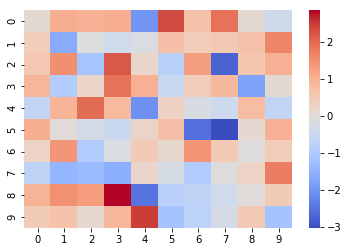

In [101]:
from matplotlib.colors import Normalize
import numpy as np
import matplotlib.cm as cm

data = np.random.randn(10, 10)
cmap = cm.get_cmap('coolwarm')
hm = sns.heatmap(data, cmap=cmap)

# Normalize data
norm = Normalize(vmin=data.min(), vmax=data.max())
rgba_values = cmap(norm(data))

In [144]:
rgba_values

array([[[0.89588177, 0.84990606, 0.82349908, 1.        ],
        [0.96889416, 0.67947956, 0.56281229, 1.        ],
        [0.96985115, 0.69583006, 0.58131177, 1.        ],
        [0.96889416, 0.67947956, 0.56281229, 1.        ],
        [0.44643064, 0.58235643, 0.95737331, 1.        ],
        [0.82529381, 0.29574884, 0.25002547, 1.        ],
        [0.9605812 , 0.76250102, 0.66796355, 1.        ],
        [0.90265893, 0.44793875, 0.34972137, 1.        ],
        [0.89588177, 0.84990606, 0.82349908, 1.        ],
        [0.80932867, 0.852974  , 0.92232259, 1.        ]],

       [[0.94343153, 0.80227625, 0.7291716 , 1.        ],
        [0.53256824, 0.6698006 , 0.99039327, 1.        ],
        [0.86339183, 0.8650838 , 0.86763388, 1.        ],
        [0.81369258, 0.85428184, 0.9184801 , 1.        ],
        [0.85137164, 0.86312531, 0.88106382, 1.        ],
        [0.96270828, 0.75355735, 0.65560121, 1.        ],
        [0.94343153, 0.80227625, 0.7291716 , 1.        ],
        [0.9

In [121]:
from folium import plugins

m = folium.Map(location=[43.46811941, -90.04569087], zoom_start=5)
data_test = [[42.35810000, -71.06360000, 0.1],
       [42.82995815, -74.78991444, 0.2],
       [43.17929819, -78.56603306, 0.4],
       [43.40320216, -82.37774519, 0.6],
       [43.49975489, -86.20965845, 0.8],
       [43.46811941, -90.04569087,   1],]
# Uncommenting following does not work either
# append 0.0 and 10 to check if color scaling works correctly
# data.append([0,0,0.0])
# data.append([0,0,1.0])
# define color map

colormap = {0.0: 'pink', 0.3: 'blue', 0.5: 'green',  0.7: 'yellow', 1: 'red'}
#gradient=colormap,

m.add_child(plugins.HeatMap(data_test , min_opacity = 0, max_val = 0.00025, gradient=colormap, blur=1))

In [94]:
m = folium.Map(location=[43.46811941, -90.04569087], zoom_start=5)
data = [[42.35810000, -71.06360000, 0.3],
        [42.82995815, -74.78991444, 0.4],
        [43.17929819, -78.56603306, 0.5],
        [43.40320216, -82.37774519, 0.6],
        [43.49975489, -86.20965845, 0.7],
        [43.46811941, -90.04569087, 0.8],]
# Uncommenting following does not work either
# append 0.0 and 10 to check if color scaling works correctly
# data.append([0,0,0.0])
# data.append([0,0,1.0])
# define color map

colormap = {0.0: 'pink', 0.3: 'blue', 0.5: 'green',  0.7: 'yellow', 1.0: 'red'}
m.add_child(plugins.HeatMap(data, min_opacity=0, max_val=0.00025, gradient=colormap))

In [118]:
with open("Cool-Warm.json") as datafile:
       data = json.load(datafile)

In [168]:
## Add BRANCA colormap ##
gradient_dict = {}
import branca.colormap as branca_folium_cm
colormap = branca_folium_cm.linear.Blues_05.scale(0, 110)
colormap.caption = "Bla bla"  # how do I change fontsize and color here?
# folium_map.add_child(colormap)

for ind_val, c in zip(colormap.index, colormap.colors):
    # Create gradient dictionary for heatmap on the fly
    r, g, b, a = c
    gradient_dict[ind_val] = r,g,b,a

In [169]:
gradient_dict

{0.0: (0.9372549019607843, 0.9529411764705882, 1.0, 1.0),
 27.5: (0.7411764705882353, 0.8431372549019608, 0.9058823529411765, 1.0),
 55.0: (0.4196078431372549, 0.6823529411764706, 0.8392156862745098, 1.0),
 82.5: (0.19215686274509805, 0.5098039215686274, 0.7411764705882353, 1.0),
 110.0: (0.03137254901960784, 0.3176470588235294, 0.611764705882353, 1.0)}